In [0]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.4 torchvision==0.5 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 753.4MB 21kB/s 
     |████████████████████████████████| 4.0MB 38.3MB/s 
  Found existing installation: torch 1.5.0+cu101
    Uninstalling torch-1.5.0+cu101:
      Successfully uninstalled torch-1.5.0+cu101
  Found existing installation: torchvision 0.6.0+cu101
    Uninstalling torchvision-0.6.0+cu101:
      Successfully uninstalled torchvision-0.6.0+cu101


     |████████████████████████████████| 276kB 6.4MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44074 sha256=c724f3f9140061175daf893abddf2a524e276e5291714fedea3f0264534fbc20
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-1kp60zue
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-1kp60zue
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=275263 sha256=e9fde3e55a60108b0eb25558333d6647e3e5b1a666a7188c5cea054f2cb27ffb
  Stored in directory: /tmp/pip-ephem-wheel-cache-qrm0tadp/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing install

In [1]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html
     |████████████████████████████████| 6.2MB 798kB/s 
  Created wheel for fvcore: filename=fvcore-0.1.dev200502-cp36-none-any.whl size=40567 sha256=83f959d816b97073f2eda68165cfc72d58ad76c4cd52f9b1a7f54bb881211ede
  Stored in directory: /root/.cache/pip/wheels/6c/e2/78/df116f1145ba7dd76f3103f13effc7dca51923bf618d0b53c7
Successfully built fvcore


In [0]:
import os, sys
import ntpath

import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import itertools
import numpy as np
import pandas as pd
import cv2
import random
import matplotlib.pyplot as plt
import urllib
import PIL.Image as Image
from tqdm import tqdm
#from matplotlib.pyplot import imshow as cv2_imshow
from google.colab.patches import cv2_imshow
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_test_loader
from detectron2.structures import BoxMode
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

In [0]:
plt.rcParams['figure.figsize'] = [15, 12]

In [4]:
!wget https://thesurfingsource.com/wp-content/uploads/2020/04/two-men-carrying-surfboards-near-seashore-1667018-scaled.jpg -O input.jpg

--2020-05-03 21:52:04--  https://thesurfingsource.com/wp-content/uploads/2020/04/two-men-carrying-surfboards-near-seashore-1667018-scaled.jpg
Resolving thesurfingsource.com (thesurfingsource.com)... 52.23.4.3
Connecting to thesurfingsource.com (thesurfingsource.com)|52.23.4.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 909662 (888K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>] 888.34K  1.87MB/s    in 0.5s    

2020-05-03 21:52:05 (1.87 MB/s) - ‘input.jpg’ saved [909662/909662]



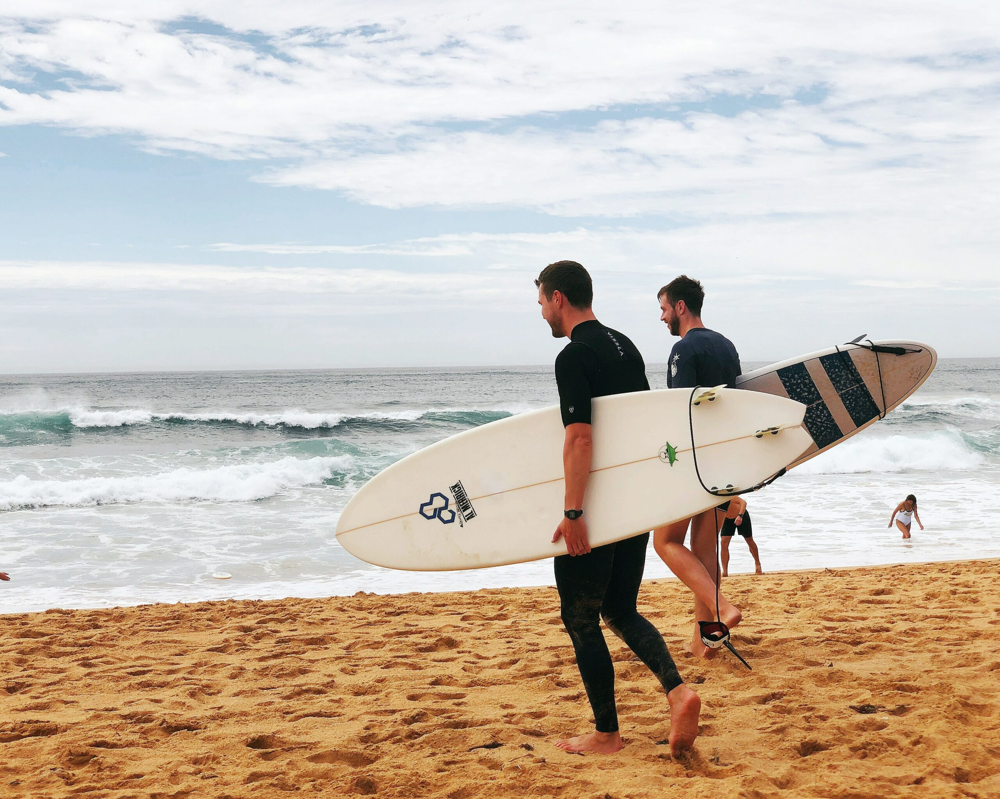

In [6]:
im = cv2.imread('input.jpg')
cv2_imshow(im)

In [7]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

model_final_f10217.pkl: 178MB [00:17, 10.1MB/s]                           


In [8]:
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[1366.5048,  681.2097, 1800.7200, 1955.4259],
        [ 843.7477,  968.3375, 2159.5420, 1455.9482],
        [2272.5198, 1265.7725, 2367.2688, 1379.1195],
        [1662.3445,  687.6367, 1935.2065, 1725.4376],
        [1682.4814,  703.5031, 1895.0490,  993.9190],
        [1663.6746, 1288.5032, 1922.7349, 1719.4869],
        [1834.0918, 1278.4402, 1953.0656, 1479.1250],
        [1690.8480,  868.7785, 2403.8311, 1288.5579]], device='cuda:0'))

In [9]:
outputs["instances"].pred_classes

tensor([ 0, 37,  0,  0,  0,  0,  0, 37], device='cuda:0')

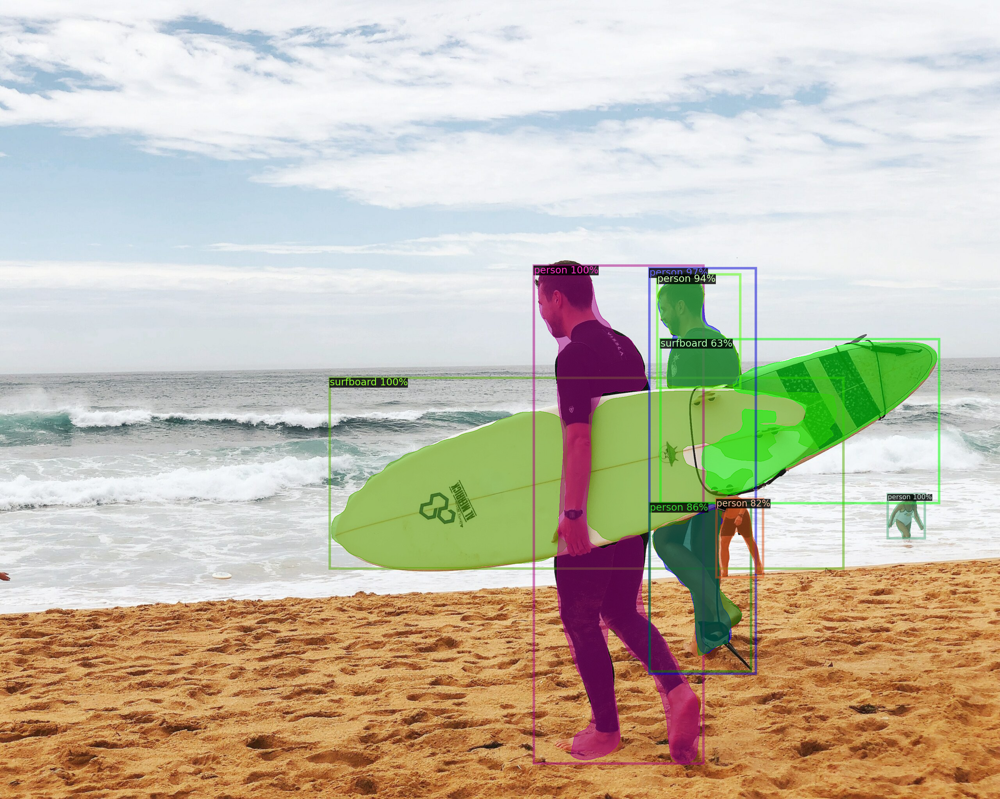

In [10]:
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

### Train on Custom Set
Try adding a class using a faces dataset found on Kaggle.

In [13]:
!pip install kaggle

!mkdir .kaggle
!touch .kaggle/kaggle.json

api_token = {"username":"kaipak","key":"f832b14ff0d8d858b5462f8e5b48430a"}

import json
import zipfile
import os
with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 /root/.kaggle/kaggle.json
#!kaggle config set -p /content

mkdir: cannot create directory ‘.kaggle’: File exists
usage: kaggle config set [-h] -n NAME -v VALUE
kaggle config set: error: argument -n/--name is required


In [14]:
!kaggle datasets download -d dataturks/face-detection-in-images

  0% 0.00/55.3k [00:00<?, ?B/s]
100% 55.3k/55.3k [00:00<00:00, 50.2MB/s]


In [15]:
!unzip ./face-detection-in-images.zip

Archive:  ./face-detection-in-images.zip
  inflating: face_detection.json     


In [16]:
faces = pd.read_json('face_detection.json', lines=True)
faces.head()

,content,annotation,extras
0,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
1,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
2,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
3,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN
4,http://com.dataturks.a96-i23.open.s3.amazonaws...,"[{'label': ['Face'], 'notes': '', 'points': [{...",NaN


In [17]:
os.makedirs('images/faces', exist_ok=True)

dataset = []

for index, row in tqdm(faces.iterrows(), total=faces.shape[0]):
    img = urllib.request.urlopen(row["content"])
    img = Image.open(img)
    img = img.convert('RGB')

    image_name = f'face_{index}.jpeg'

    img.save(f'images/faces/{image_name}', "JPEG")

    annotations = row['annotation']
    for an in annotations:

        data = {}

        width = an['imageWidth']
        height = an['imageHeight']
        points = an['points']
  
        data['file_name'] = image_name
        data['width'] = width
        data['height'] = height

        data["x_min"] = int(round(points[0]["x"] * width))
        data["y_min"] = int(round(points[0]["y"] * height))
        data["x_max"] = int(round(points[1]["x"] * width))
        data["y_max"] = int(round(points[1]["y"] * height))

        data['class_name'] = 'face'

        dataset.append(data)

100%|██████████| 409/409 [03:28<00:00,  1.96it/s]


In [18]:
df_annot = pd.DataFrame(dataset)
df_annot.head()
print(df_annot['file_name'].unique().shape)

(409,)


In [0]:
df_annot.to_csv('images/faces/annotations.csv', header=True, index=None)

In [0]:
def annotate_image(annotations, resize=True):
  file_name = annotations.file_name.to_numpy()[0]
  img = cv2.cvtColor(cv2.imread(f'images/faces/{file_name}'), cv2.COLOR_BGR2RGB)

  for i, a in annotations.iterrows():
    cv2.rectangle(img, (a.x_min, a.y_min), (a.x_max, a.y_max), (0, 255, 0), 2)

  if not resize:
    return img

  return cv2.resize(img, (384, 384), interpolation = cv2.INTER_AREA)

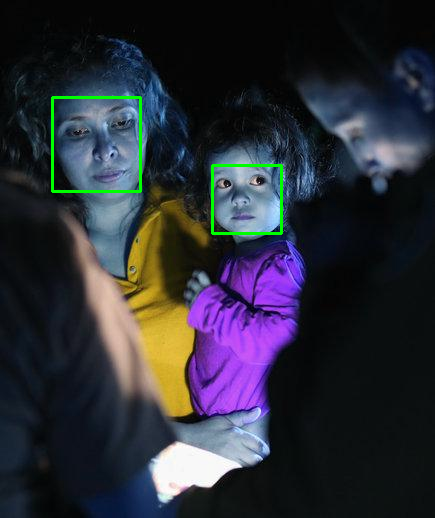

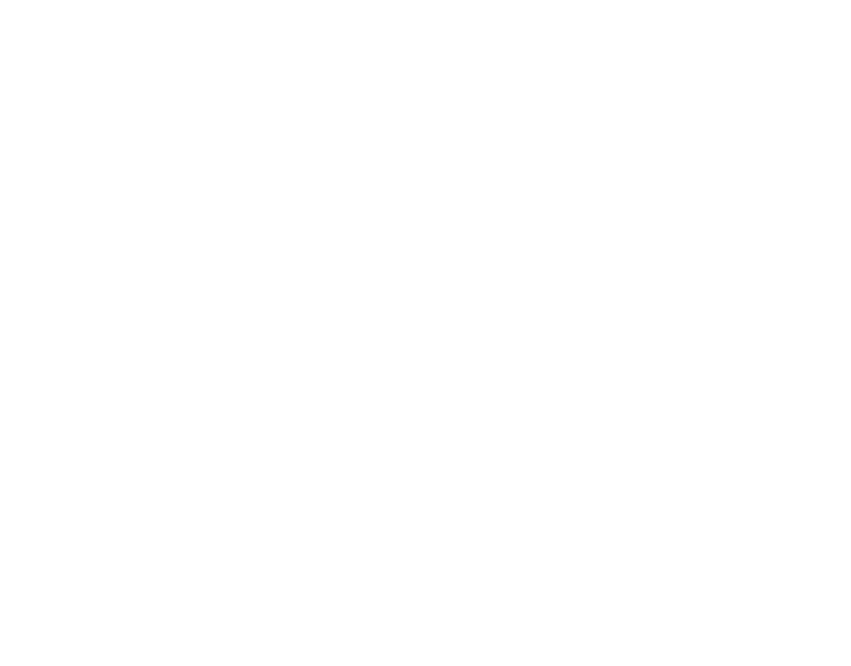

In [26]:
rand_ind = np.random.randint(409)
img_df = df_annot[df_annot.file_name == df_annot.file_name.unique()[rand_ind]]
img = annotate_image(img_df, resize=False)

cv2_imshow(img)
plt.axis('off');

# Retrain the Model

In [7]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
IMAGES_PATH = f'/content/gdrive/My Drive/Colab/data/faces'
df_annot = pd.read_csv('/content/gdrive/My Drive/Colab/data/faces/annotations.csv')

uniq_files = df_annot.file_name.unique()
train_files = set(np.random.choice(uniq_files, int(len(uniq_files) * 0.95), replace=False))
train_df = df_annot[df_annot.file_name.isin(train_files)]
test_df = df_annot[~df_annot.file_name.isin(train_files)]

In [9]:
classes = df_annot.class_name.unique().tolist()
classes

['face']

In [10]:
test_df.head()

,file_name,width,height,x_min,y_min,x_max,y_max,class_name
35,face_13.jpeg,1400,642,340,93,494,234,face
36,face_13.jpeg,1400,642,494,225,648,413,face
37,face_13.jpeg,1400,642,699,266,880,439,face
38,face_13.jpeg,1400,642,895,68,1030,235,face
52,face_22.jpeg,525,386,415,77,472,144,face


In [0]:
def create_dataset_dicts(df, classes):
  dataset_dicts = []
  for image_id, img_name in enumerate(df.file_name.unique()):

    record = {}

    image_df = df[df.file_name == img_name]

    file_path = f'{IMAGES_PATH}/{img_name}'
    record["file_name"] = file_path
    record["image_id"] = image_id
    record["height"] = int(image_df.iloc[0].height)
    record["width"] = int(image_df.iloc[0].width)

    objs = []
    for _, row in image_df.iterrows():

      xmin = int(row.x_min)
      ymin = int(row.y_min)
      xmax = int(row.x_max)
      ymax = int(row.y_max)

      poly = [
          (xmin, ymin), (xmax, ymin),
          (xmax, ymax), (xmin, ymax)
      ]
      poly = list(itertools.chain.from_iterable(poly))

      obj = {
        "bbox": [xmin, ymin, xmax, ymax],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": classes.index(row.class_name),
        "iscrowd": 0
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)
  return dataset_dicts

In [0]:
for d in ["train", "val"]:
  DatasetCatalog.register("faces_" + d, lambda d=d: create_dataset_dicts(train_df if d == "train" else test_df, classes))
  MetadataCatalog.get("faces_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("faces_train")

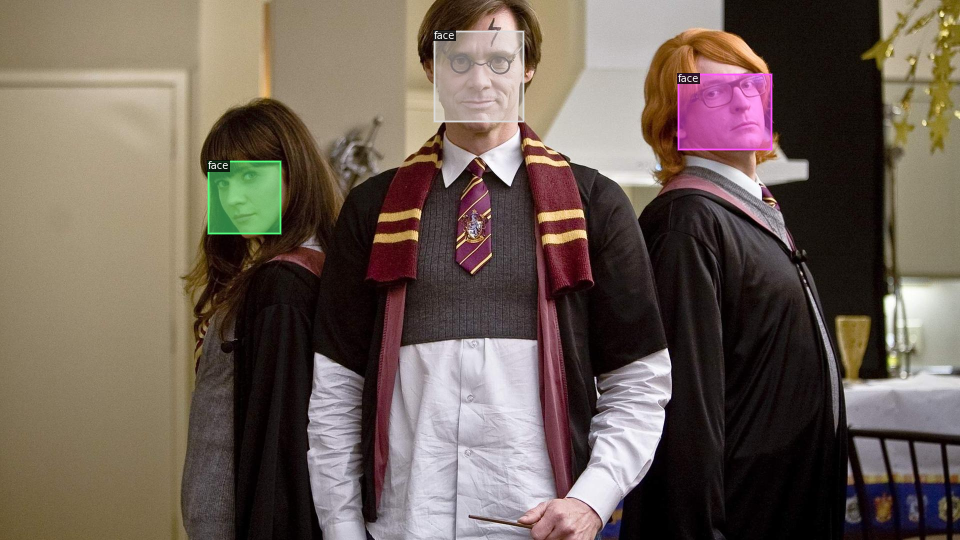

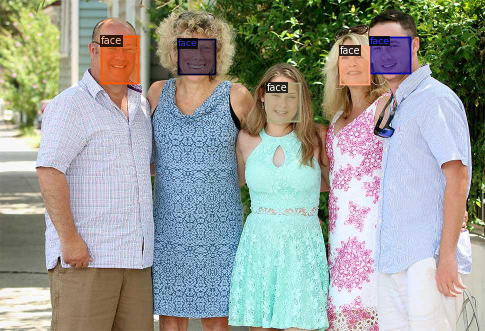

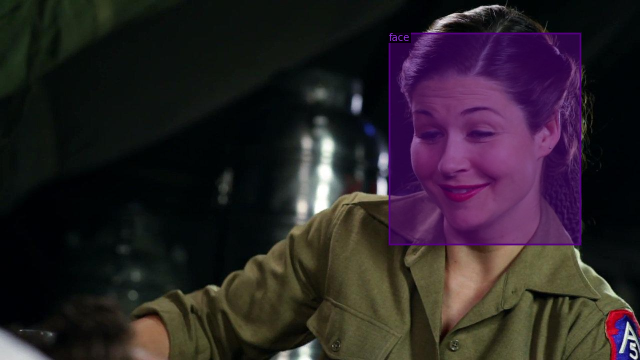

In [13]:
dataset_dicts = create_dataset_dicts(train_df, classes)
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [0]:
class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [0]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg


cfg = get_cfg()
cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
  )
)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
)
cfg.DATASETS.TRAIN = ("faces_train",)
cfg.DATASETS.TEST = ("faces_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 300
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)
# cfg.TEST.EVAL_PERIOD = 500

In [26]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/03 22:31:31 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)

In [31]:
evaluator = COCOEvaluator("faces_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "faces_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/03 22:42:27 d2.data.common]: Serializing 21 elements to byte tensors and concatenating them all ...
[05/03 22:42:27 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/03 22:42:27 d2.evaluation.evaluator]: Start inference on 21 images
[05/03 22:42:29 d2.evaluation.evaluator]: Inference done 11/21. 0.0923 s / img. ETA=0:00:01
[05/03 22:42:31 d2.evaluation.evaluator]: Total inference time: 0:00:02.404260 (0.150266 s / img per device, on 1 devices)
[05/03 22:42:31 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.089329 s / img per device, on 1 devices)
[05/03 22:42:31 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/03 22:42:31 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[05/03 22:42:31 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE 

OrderedDict([('bbox',
              {'AP': 28.35412950203637,
               'AP50': 67.54042762210051,
               'AP75': 19.24588728658127,
               'APl': 34.86620345660707,
               'APm': 16.84764803991136,
               'APs': nan}),
             ('segm',
              {'AP': 27.27956092416494,
               'AP50': 70.08023744492387,
               'AP75': 18.601117681415623,
               'APl': 33.50706884416958,
               'APm': 16.585516556110743,
               'APs': nan})])

In [0]:
os.makedirs("annotated_results", exist_ok=True)

test_image_paths = test_df.file_name.unique()

In [0]:
for clothing_image in test_image_paths:
  file_path = f'{IMAGES_PATH}/{clothing_image}'
  im = cv2.imread(file_path)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata,
    scale=1.,
    instance_mode=ColorMode.IMAGE
  )
  instances = outputs["instances"].to("cpu")
  instances.remove('pred_masks')
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(clothing_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [0]:
annotated_images = [f'annotated_results/{f}' for f in test_df.file_name.unique()]

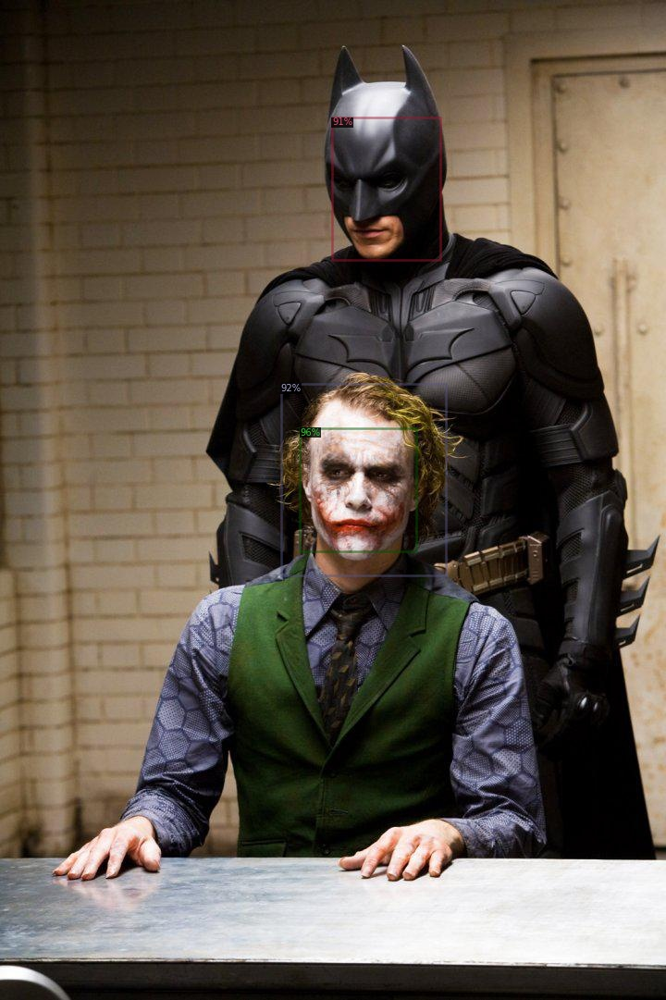

In [52]:
idx = np.random.randint(len(annotated_images))
img = cv2.imread(annotated_images[idx])
cv2_imshow(img)

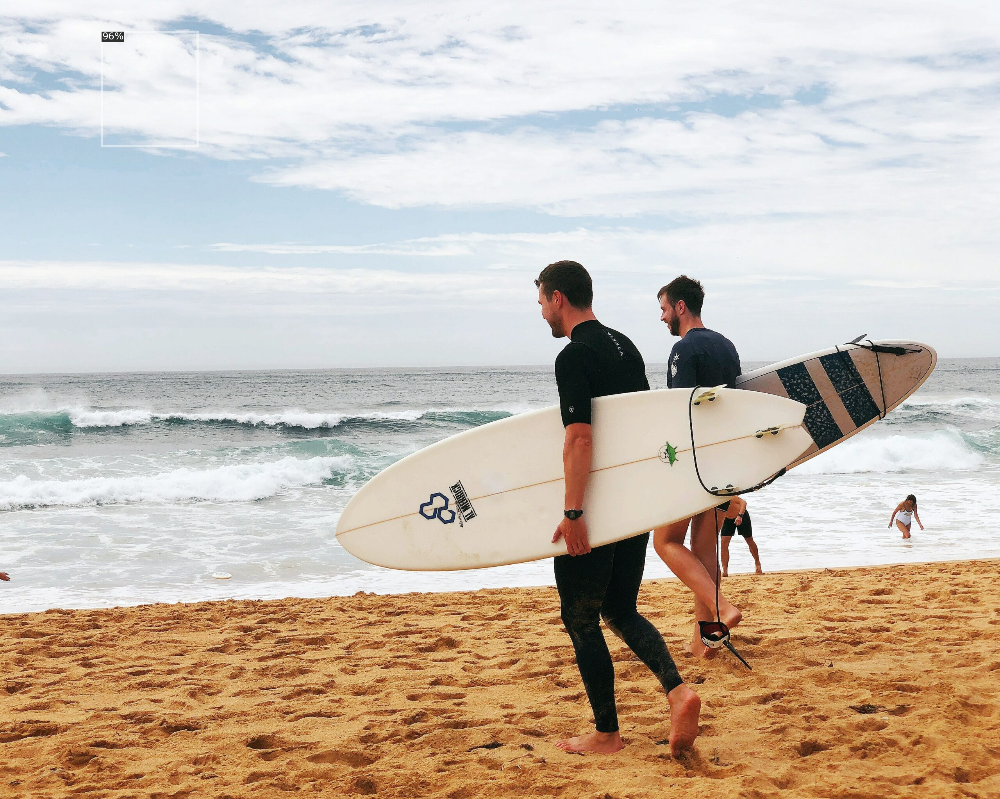

In [49]:
# try on surfer image from earlier
im = cv2.imread('input.jpg')
output = predictor(im)
v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata,
    scale=1.,
    instance_mode=ColorMode.IMAGE
)
instances = outputs["instances"].to("cpu")
instances.remove('pred_masks')
v = v.draw_instance_predictions(instances)
result = v.get_image()[:, :, ::-1]

cv2_imshow(result)

### Panoptic Segmentation Model

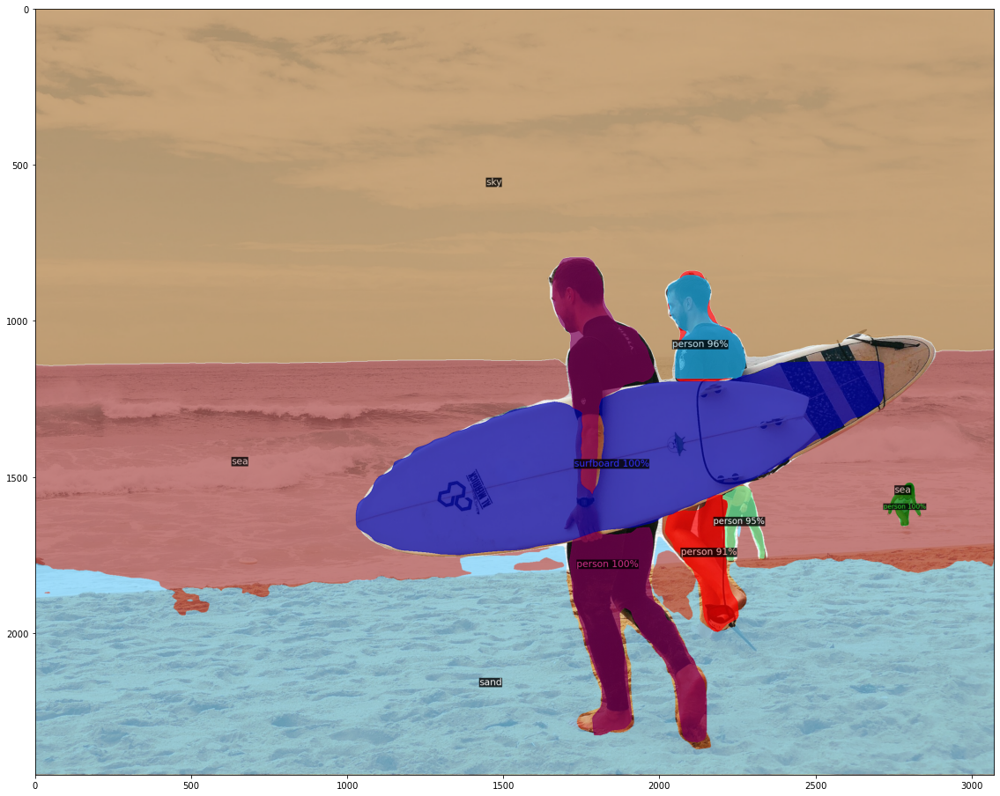

In [0]:
# Inference with a panoptic segmentation model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(v.get_image()[:, :, ::-1])